## HW 1 KORNEINKO DMITRII

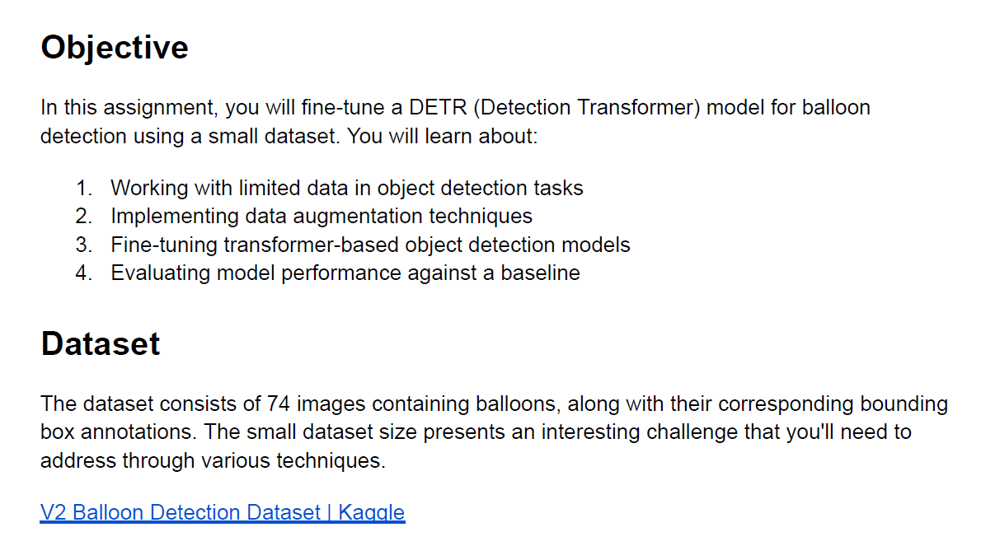

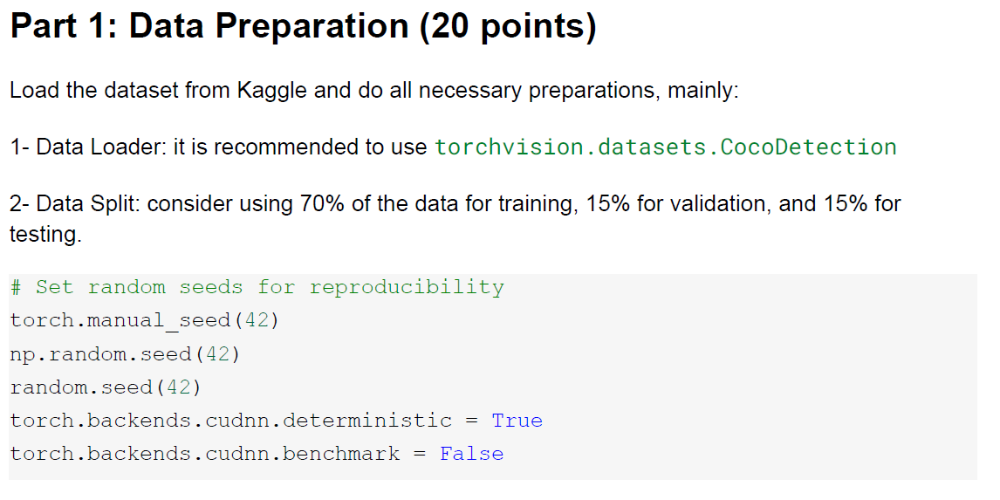

In [205]:
import os
import torch
import numpy as np
import random
from torchvision.datasets import CocoDetection
from torchvision.transforms import ToTensor
from tqdm import tqdm
import pandas as pd
from sklearn.model_selection import train_test_split
from PIL import Image
from pathlib import Path
from transformers import DetrForObjectDetection, DetrImageProcessor
from torch.utils.data import Dataset, DataLoader
from albumentations import Compose, HorizontalFlip, RandomBrightnessContrast, ShiftScaleRotate, Resize
import albumentations as A
from albumentations.pytorch import ToTensorV2
import matplotlib.pyplot as plt
from torchvision import transforms

In [206]:
torch.manual_seed(42)
np.random.seed(42)
random.seed(42)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

In [207]:
class CustomDataset(Dataset):
    def __init__(self, annotation_df, images_dir, shuffle=False, augmentations=None):
        self.annotations = annotation_df
        self.fname = self.annotations.columns.get_loc('fname')
        self.bbox = self.annotations.columns.get_loc('bbox')
        self.height = self.annotations.columns.get_loc('height')
        self.width = self.annotations.columns.get_loc('width')
        self.images_dir = images_dir
        self.augmentations = augmentations
        self.is_augmented = [0 for _ in range(len(self.annotations))]
        if self.augmentations:
            self.is_augmented += [1 for _ in range(len(self.annotations))]
            self.annotations = pd.concat([self.annotations, self.annotations], axis=0).reset_index(drop=True)
        
        self.augmentations_resize = Compose(
            [Resize(height=512, width=512)],
            bbox_params=A.BboxParams(format="coco", label_fields=["class_labels"])
        )
            
        if shuffle:
            permutation = np.random.permutation(len(self.annotations))
            self.annotations = self.annotations.iloc[permutation].reset_index(drop=True)
            self.is_augmented = np.array(self.is_augmented)[permutation]
            
    def __len__(self):
        return len(self.annotations)
    
    def __getitem__(self, i):
        img_path = os.path.join(self.images_dir, self.annotations.iloc[i, self.fname])
        image = np.array(Image.open(img_path).convert("RGB"))
        height, width = self.annotations.iloc[i, self.height], self.annotations.iloc[i, self.width]
        
        bboxes = []
        for bbox in eval(self.annotations.iloc[i, self.bbox]):
            xmin, ymin, xmax, ymax = bbox['xmin'], bbox['ymin'], bbox['xmax'], bbox['ymax']
            bboxes.append([xmin, ymin, (xmax-xmin), (ymax-ymin)])

        class_labels = [1] * len(bboxes)  

        if self.is_augmented[i]:
            augmented = self.augmentations(image=image, bboxes=bboxes, class_labels=class_labels)
            image = augmented['image']
            bboxes = augmented['bboxes']
            class_labels = augmented['class_labels']
        
        augmented = self.augmentations_resize(image=image, bboxes=bboxes, class_labels=class_labels)
        image = augmented['image']
        bboxes = []
        box_h, box_w = augmented['image'].shape[0], augmented['image'].shape[1]
        for b in augmented['bboxes']:
            bboxes.append([b[0] / box_w, b[1] / box_h, b[2] / box_w, b[3] / box_h])
        
        return transforms.ToTensor()(image), bboxes, class_labels

In [208]:
annotation_file = 'balloon-data.csv'
images_dir = './images'
data = pd.read_csv(annotation_file)

# split data
train_data, test_data = train_test_split(data, test_size=24, random_state=42)  # 50
val_data, test_data = train_test_split(test_data, test_size=12, random_state=42)  # 12 + 12

def collate_fn(x):
    return tuple(zip(*x))

train_dataset = CustomDataset(annotation_df=train_data, images_dir=images_dir, shuffle=True)
train_loader = DataLoader(train_dataset, batch_size=3, shuffle=True, num_workers=0, collate_fn=collate_fn)

val_dataset = CustomDataset(annotation_df=val_data, images_dir=images_dir, shuffle=False)
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, num_workers=0, collate_fn=collate_fn)

test_dataset = CustomDataset(annotation_df=test_data, images_dir=images_dir, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=4, shuffle=False, num_workers=0, collate_fn=collate_fn)


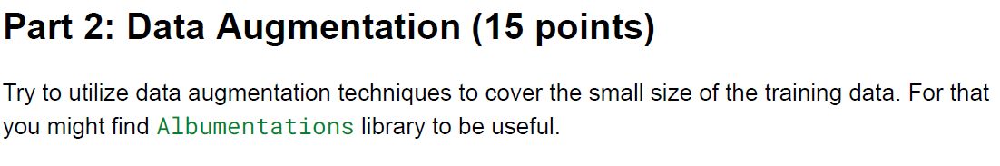

In [235]:
from albumentations import (
    Compose,
    HorizontalFlip,
    VerticalFlip,
    RandomBrightnessContrast,
    RandomGamma,
    GaussianBlur,
    ShiftScaleRotate,
    Resize,
    HueSaturationValue,
    OneOf,
    CoarseDropout,
    RandomRotate90,
    Rotate,
    RandomCrop,
    RandomScale,
    Normalize,
    RandomFog,
    RandomRain,
    RandomShadow,
)

augmentations = Compose(
    [
        OneOf([
            HorizontalFlip(p=0.5),  
            VerticalFlip(p=0.5)     
        ], p=0.5),  

        OneOf([
            RandomRotate90(p=0.5),  
            Rotate(limit=30, p=0.5) 
        ], p=0.5),  

        RandomBrightnessContrast(p=0.6),  
        RandomGamma(gamma_limit=(50, 200), p=0.5),  
        HueSaturationValue(hue_shift_limit=30, sat_shift_limit=30, val_shift_limit=30, p=0.5),  
        GaussianBlur(blur_limit=(3, 5), p=0.1),  
        ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1, rotate_limit=15, p=0.3),  
        RandomCrop(height=512, width=512, p=0.5),  
        RandomScale(scale_limit=(0.8, 1.2), p=0.5),  
        CoarseDropout(max_holes=1, max_height=8, max_width=8, p=0.1),  
        Resize(512, 512),  
        Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),  
        OneOf([
            RandomFog(p=0.3),
            RandomRain(p=0.3),
            RandomShadow(p=0.3)
        ], p=0.3)
    ],
    bbox_params=A.BboxParams(format="coco", label_fields=["class_labels"])
)

train_dataset_augmented = CustomDataset(
    annotation_df=train_data,
    images_dir=images_dir,
    shuffle=False,
    augmentations=augmentations
)

train_loader_augmented = DataLoader(
    train_dataset_augmented,
    batch_size=4,
    shuffle=True,
    num_workers=0,
    collate_fn=collate_fn
)

- HorizontalFlip(p=0.5): To handle balloons that might appear mirrored horizontally.
- VerticalFlip(p=0.5): To handle balloons that might appear mirrored vertically.
- RandomRotate90(p=0.5): To account for balloons oriented at 90-degree angles.
- Rotate(limit=30, p=0.5): To simulate slightly rotated balloons in natural scenarios.
- RandomBrightnessContrast(p=0.6): To adjust for lighting variations in balloon environments.
- RandomGamma(gamma_limit=(50, 200), p=0.5): To simulate different exposure levels in images.
- HueSaturationValue(hue_shift_limit=30, sat_shift_limit=30, val_shift_limit=30, p=0.5): To capture variations in balloon colors due to lighting or material.
- GaussianBlur(blur_limit=(3, 5), p=0.1): To mimic slight out-of-focus effects on balloons.
- ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1, rotate_limit=15, p=0.3): To account for slight positional and scaling variations of balloons.
- RandomCrop(height=512, width=512, p=0.5): To deal with partially visible balloons in cropped images.
- RandomScale(scale_limit=(0.8, 1.2), p=0.5): To simulate balloons of varying sizes.
- CoarseDropout(max_holes=1, max_height=8, max_width=8, p=0.1): To represent minor occlusions on balloons.
- Resize(512, 512): To standardize balloon image dimensions for consistent processing.
- Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)): To normalize image data for better model performance.
- RandomFog(p=0.3): To replicate foggy conditions where balloons might appear blurred.
- RandomRain(p=0.3): To simulate rainy conditions affecting balloon visibility.
- RandomShadow(p=0.3): To account for shadows cast on balloons in outdoor settings.


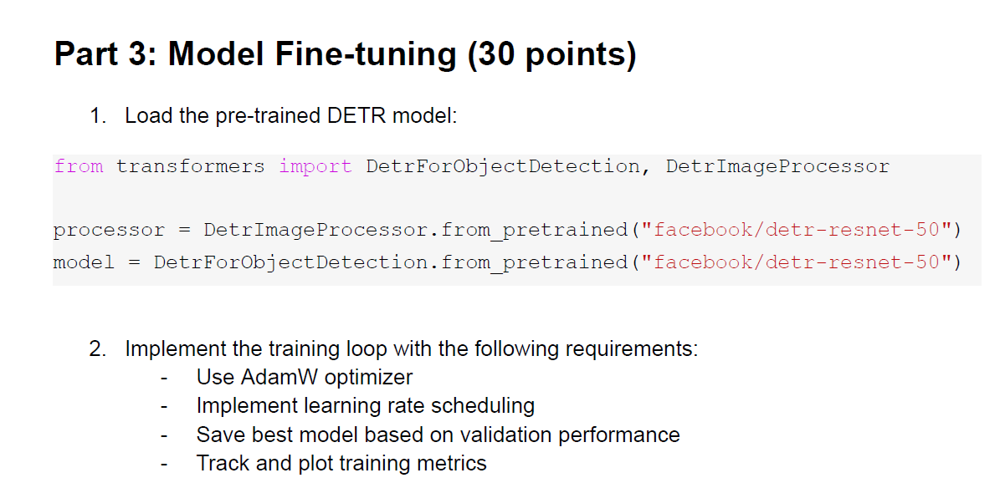

In [236]:
import os
import torch
import numpy as np
import random
import pandas as pd
from tqdm import tqdm
from transformers import DetrForObjectDetection, DetrImageProcessor

In [237]:
processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")
model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

num_epochs = 50
learning_rate = 5e-6
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)
best_val_loss = None
val_losses, train_losses = [], []

from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter()

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0

    for images, boxes, class_labels in tqdm(train_loader_augmented, desc=f"Training Epoch {epoch + 1}/{num_epochs}"):
        images = torch.stack([image.to(device) for image in images])
        pixel_mask = torch.ones((images.size(0), images.size(2), images.size(3)), device=device, dtype=torch.bool)

        targets = [
            {
                "boxes": torch.tensor(box, dtype=torch.float32).to(device),
                "class_labels": torch.tensor(class_labels[i], dtype=torch.int64).to(device)
            } 
            for i, box in enumerate(boxes)
        ]

        optimizer.zero_grad()
        outputs = model(images, pixel_mask=pixel_mask, labels=targets)
        loss = outputs.loss
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    avg_train_loss = running_loss / len(train_loader_augmented)
    print(f"Epoch [{epoch + 1}/{num_epochs}], Training Loss: {avg_train_loss:.4f}")
    train_losses.append(avg_train_loss)
    writer.add_scalar('Loss/Train', avg_train_loss, epoch)
    
    #validation
    model.eval()
    val_loss = 0
    with torch.no_grad():
        for images, boxes, class_labels in tqdm(val_loader, desc=f"Validation Epoch {epoch + 1}/{num_epochs}"):
            images = torch.stack([image.to(device) for image in images])
            pixel_mask = torch.ones((images.size(0), images.size(2), images.size(3)), device=device, dtype=torch.bool)
            targets = [
                {
                    "boxes": torch.tensor(box, dtype=torch.float32).to(device),
                    "class_labels": torch.tensor(class_labels[i], dtype=torch.int64).to(device)
                } 
                for i, box in enumerate(boxes)
            ]

            outputs = model(images, pixel_mask=pixel_mask, labels=targets)
            val_loss += outputs.loss.item()

    avg_val_loss = val_loss / len(val_loader)
    print(f"Epoch [{epoch + 1}/{num_epochs}], Validation Loss: {avg_val_loss:.4f}\n")
    val_losses.append(avg_val_loss)

    writer.add_scalar('Loss/Validation', avg_val_loss, epoch)

    if best_val_loss is None or val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save(model.state_dict(), "best_model.pth")

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Training Epoch 1/50:   4%|▍         | 1/25 [00:02<00:56,  2.34s/it]c:\Users\Mi\AppDa

Epoch [1/50], Training Loss: 5.7383


Validation Epoch 1/50: 100%|██████████| 3/3 [00:02<00:00,  1.30it/s]


Epoch [1/50], Validation Loss: 6.4674



Training Epoch 2/50: 100%|██████████| 25/25 [00:48<00:00,  1.94s/it]


Epoch [2/50], Training Loss: 5.0978


Validation Epoch 2/50: 100%|██████████| 3/3 [00:02<00:00,  1.17it/s]


Epoch [2/50], Validation Loss: 5.6900



Training Epoch 3/50: 100%|██████████| 25/25 [00:50<00:00,  2.01s/it]


Epoch [3/50], Training Loss: 4.9757


Validation Epoch 3/50: 100%|██████████| 3/3 [00:02<00:00,  1.24it/s]


Epoch [3/50], Validation Loss: 5.6159



Training Epoch 4/50: 100%|██████████| 25/25 [00:50<00:00,  2.01s/it]


Epoch [4/50], Training Loss: 4.8238


Validation Epoch 4/50: 100%|██████████| 3/3 [00:02<00:00,  1.17it/s]


Epoch [4/50], Validation Loss: 5.3174



Training Epoch 5/50: 100%|██████████| 25/25 [00:52<00:00,  2.10s/it]


Epoch [5/50], Training Loss: 4.5864


Validation Epoch 5/50: 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]


Epoch [5/50], Validation Loss: 4.6421



Training Epoch 6/50: 100%|██████████| 25/25 [00:54<00:00,  2.16s/it]


Epoch [6/50], Training Loss: 4.1612


Validation Epoch 6/50: 100%|██████████| 3/3 [00:02<00:00,  1.18it/s]


Epoch [6/50], Validation Loss: 4.1010



Training Epoch 7/50: 100%|██████████| 25/25 [00:49<00:00,  1.99s/it]


Epoch [7/50], Training Loss: 3.9940


Validation Epoch 7/50: 100%|██████████| 3/3 [00:02<00:00,  1.30it/s]


Epoch [7/50], Validation Loss: 3.9313



Training Epoch 8/50: 100%|██████████| 25/25 [00:49<00:00,  1.98s/it]


Epoch [8/50], Training Loss: 3.8803


Validation Epoch 8/50: 100%|██████████| 3/3 [00:02<00:00,  1.24it/s]


Epoch [8/50], Validation Loss: 3.7983



Training Epoch 9/50: 100%|██████████| 25/25 [00:51<00:00,  2.05s/it]


Epoch [9/50], Training Loss: 3.8237


Validation Epoch 9/50: 100%|██████████| 3/3 [00:02<00:00,  1.21it/s]


Epoch [9/50], Validation Loss: 3.6666



Training Epoch 10/50: 100%|██████████| 25/25 [00:50<00:00,  2.02s/it]


Epoch [10/50], Training Loss: 3.5090


Validation Epoch 10/50: 100%|██████████| 3/3 [00:02<00:00,  1.21it/s]


Epoch [10/50], Validation Loss: 3.3007



Training Epoch 11/50: 100%|██████████| 25/25 [00:51<00:00,  2.05s/it]


Epoch [11/50], Training Loss: 3.4683


Validation Epoch 11/50: 100%|██████████| 3/3 [00:02<00:00,  1.27it/s]


Epoch [11/50], Validation Loss: 3.2616



Training Epoch 12/50: 100%|██████████| 25/25 [00:47<00:00,  1.90s/it]


Epoch [12/50], Training Loss: 3.5599


Validation Epoch 12/50: 100%|██████████| 3/3 [00:02<00:00,  1.28it/s]


Epoch [12/50], Validation Loss: 3.0789



Training Epoch 13/50: 100%|██████████| 25/25 [00:47<00:00,  1.92s/it]


Epoch [13/50], Training Loss: 3.4859


Validation Epoch 13/50: 100%|██████████| 3/3 [00:02<00:00,  1.30it/s]


Epoch [13/50], Validation Loss: 2.9895



Training Epoch 14/50: 100%|██████████| 25/25 [00:47<00:00,  1.91s/it]


Epoch [14/50], Training Loss: 3.2908


Validation Epoch 14/50: 100%|██████████| 3/3 [00:02<00:00,  1.30it/s]


Epoch [14/50], Validation Loss: 2.7843



Training Epoch 15/50: 100%|██████████| 25/25 [00:47<00:00,  1.91s/it]


Epoch [15/50], Training Loss: 3.2487


Validation Epoch 15/50: 100%|██████████| 3/3 [00:02<00:00,  1.30it/s]


Epoch [15/50], Validation Loss: 2.6086



Training Epoch 16/50: 100%|██████████| 25/25 [00:48<00:00,  1.92s/it]


Epoch [16/50], Training Loss: 3.2794


Validation Epoch 16/50: 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]


Epoch [16/50], Validation Loss: 2.4386



Training Epoch 17/50: 100%|██████████| 25/25 [00:47<00:00,  1.90s/it]


Epoch [17/50], Training Loss: 3.2357


Validation Epoch 17/50: 100%|██████████| 3/3 [00:02<00:00,  1.28it/s]


Epoch [17/50], Validation Loss: 2.3728



Training Epoch 18/50: 100%|██████████| 25/25 [00:47<00:00,  1.91s/it]


Epoch [18/50], Training Loss: 2.9034


Validation Epoch 18/50: 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]


Epoch [18/50], Validation Loss: 2.3339



Training Epoch 19/50: 100%|██████████| 25/25 [00:47<00:00,  1.91s/it]


Epoch [19/50], Training Loss: 2.9202


Validation Epoch 19/50: 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]


Epoch [19/50], Validation Loss: 2.2092



Training Epoch 20/50: 100%|██████████| 25/25 [00:47<00:00,  1.92s/it]


Epoch [20/50], Training Loss: 2.9104


Validation Epoch 20/50: 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]


Epoch [20/50], Validation Loss: 2.1751



Training Epoch 21/50: 100%|██████████| 25/25 [00:48<00:00,  1.95s/it]


Epoch [21/50], Training Loss: 2.8358


Validation Epoch 21/50: 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]


Epoch [21/50], Validation Loss: 2.1531



Training Epoch 22/50: 100%|██████████| 25/25 [00:57<00:00,  2.29s/it]


Epoch [22/50], Training Loss: 2.7074


Validation Epoch 22/50: 100%|██████████| 3/3 [00:02<00:00,  1.24it/s]


Epoch [22/50], Validation Loss: 2.1460



Training Epoch 23/50: 100%|██████████| 25/25 [00:50<00:00,  2.01s/it]


Epoch [23/50], Training Loss: 2.8864


Validation Epoch 23/50: 100%|██████████| 3/3 [00:02<00:00,  1.28it/s]


Epoch [23/50], Validation Loss: 2.0934



Training Epoch 24/50: 100%|██████████| 25/25 [00:48<00:00,  1.95s/it]


Epoch [24/50], Training Loss: 2.7656


Validation Epoch 24/50: 100%|██████████| 3/3 [00:02<00:00,  1.26it/s]


Epoch [24/50], Validation Loss: 2.1471



Training Epoch 25/50: 100%|██████████| 25/25 [00:49<00:00,  1.97s/it]


Epoch [25/50], Training Loss: 2.6196


Validation Epoch 25/50: 100%|██████████| 3/3 [00:02<00:00,  1.28it/s]


Epoch [25/50], Validation Loss: 2.0519



Training Epoch 26/50: 100%|██████████| 25/25 [00:48<00:00,  1.95s/it]


Epoch [26/50], Training Loss: 2.5615


Validation Epoch 26/50: 100%|██████████| 3/3 [00:02<00:00,  1.28it/s]


Epoch [26/50], Validation Loss: 2.0162



Training Epoch 27/50: 100%|██████████| 25/25 [00:49<00:00,  1.96s/it]


Epoch [27/50], Training Loss: 2.6991


Validation Epoch 27/50: 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]


Epoch [27/50], Validation Loss: 1.9982



Training Epoch 28/50: 100%|██████████| 25/25 [00:49<00:00,  1.96s/it]


Epoch [28/50], Training Loss: 2.5537


Validation Epoch 28/50: 100%|██████████| 3/3 [00:02<00:00,  1.21it/s]


Epoch [28/50], Validation Loss: 1.9760



Training Epoch 29/50: 100%|██████████| 25/25 [00:49<00:00,  1.98s/it]


Epoch [29/50], Training Loss: 2.5948


Validation Epoch 29/50: 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]


Epoch [29/50], Validation Loss: 1.9609



Training Epoch 30/50: 100%|██████████| 25/25 [00:57<00:00,  2.29s/it]


Epoch [30/50], Training Loss: 2.5170


Validation Epoch 30/50: 100%|██████████| 3/3 [00:02<00:00,  1.11it/s]


Epoch [30/50], Validation Loss: 1.9313



Training Epoch 31/50: 100%|██████████| 25/25 [00:59<00:00,  2.39s/it]


Epoch [31/50], Training Loss: 2.6436


Validation Epoch 31/50: 100%|██████████| 3/3 [00:02<00:00,  1.05it/s]


Epoch [31/50], Validation Loss: 1.9101



Training Epoch 32/50: 100%|██████████| 25/25 [00:49<00:00,  1.99s/it]


Epoch [32/50], Training Loss: 2.4241


Validation Epoch 32/50: 100%|██████████| 3/3 [00:02<00:00,  1.26it/s]


Epoch [32/50], Validation Loss: 1.9235



Training Epoch 33/50: 100%|██████████| 25/25 [00:49<00:00,  1.97s/it]


Epoch [33/50], Training Loss: 2.5302


Validation Epoch 33/50: 100%|██████████| 3/3 [00:02<00:00,  1.26it/s]


Epoch [33/50], Validation Loss: 1.9077



Training Epoch 34/50: 100%|██████████| 25/25 [00:48<00:00,  1.96s/it]


Epoch [34/50], Training Loss: 2.4983


Validation Epoch 34/50: 100%|██████████| 3/3 [00:02<00:00,  1.27it/s]


Epoch [34/50], Validation Loss: 1.9046



Training Epoch 35/50: 100%|██████████| 25/25 [00:54<00:00,  2.16s/it]


Epoch [35/50], Training Loss: 2.5839


Validation Epoch 35/50: 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]


Epoch [35/50], Validation Loss: 1.9003



Training Epoch 36/50: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]


Epoch [36/50], Training Loss: 2.4085


Validation Epoch 36/50: 100%|██████████| 3/3 [00:02<00:00,  1.17it/s]


Epoch [36/50], Validation Loss: 1.8921



Training Epoch 37/50: 100%|██████████| 25/25 [00:56<00:00,  2.26s/it]


Epoch [37/50], Training Loss: 2.3838


Validation Epoch 37/50: 100%|██████████| 3/3 [00:02<00:00,  1.22it/s]


Epoch [37/50], Validation Loss: 1.8835



Training Epoch 38/50: 100%|██████████| 25/25 [00:59<00:00,  2.38s/it]


Epoch [38/50], Training Loss: 2.4441


Validation Epoch 38/50: 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]


Epoch [38/50], Validation Loss: 1.8724



Training Epoch 39/50: 100%|██████████| 25/25 [00:56<00:00,  2.26s/it]


Epoch [39/50], Training Loss: 2.1896


Validation Epoch 39/50: 100%|██████████| 3/3 [00:02<00:00,  1.25it/s]


Epoch [39/50], Validation Loss: 1.8280



Training Epoch 40/50: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]


Epoch [40/50], Training Loss: 2.3619


Validation Epoch 40/50: 100%|██████████| 3/3 [00:02<00:00,  1.05it/s]


Epoch [40/50], Validation Loss: 1.7891



Training Epoch 41/50: 100%|██████████| 25/25 [00:59<00:00,  2.37s/it]


Epoch [41/50], Training Loss: 2.4378


Validation Epoch 41/50: 100%|██████████| 3/3 [00:02<00:00,  1.06it/s]


Epoch [41/50], Validation Loss: 1.7482



Training Epoch 42/50: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]


Epoch [42/50], Training Loss: 2.2447


Validation Epoch 42/50: 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]


Epoch [42/50], Validation Loss: 1.7541



Training Epoch 43/50: 100%|██████████| 25/25 [00:49<00:00,  1.97s/it]


Epoch [43/50], Training Loss: 2.2072


Validation Epoch 43/50: 100%|██████████| 3/3 [00:02<00:00,  1.25it/s]


Epoch [43/50], Validation Loss: 1.7204



Training Epoch 44/50: 100%|██████████| 25/25 [00:51<00:00,  2.06s/it]


Epoch [44/50], Training Loss: 2.3421


Validation Epoch 44/50: 100%|██████████| 3/3 [00:02<00:00,  1.20it/s]


Epoch [44/50], Validation Loss: 1.7210



Training Epoch 45/50: 100%|██████████| 25/25 [00:52<00:00,  2.10s/it]


Epoch [45/50], Training Loss: 1.9972


Validation Epoch 45/50: 100%|██████████| 3/3 [00:02<00:00,  1.23it/s]


Epoch [45/50], Validation Loss: 1.6593



Training Epoch 46/50: 100%|██████████| 25/25 [00:50<00:00,  2.03s/it]


Epoch [46/50], Training Loss: 2.2357


Validation Epoch 46/50: 100%|██████████| 3/3 [00:02<00:00,  1.09it/s]


Epoch [46/50], Validation Loss: 1.6640



Training Epoch 47/50: 100%|██████████| 25/25 [00:59<00:00,  2.37s/it]


Epoch [47/50], Training Loss: 2.0149


Validation Epoch 47/50: 100%|██████████| 3/3 [00:02<00:00,  1.05it/s]


Epoch [47/50], Validation Loss: 1.6245



Training Epoch 48/50: 100%|██████████| 25/25 [00:48<00:00,  1.96s/it]


Epoch [48/50], Training Loss: 2.3311


Validation Epoch 48/50: 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]


Epoch [48/50], Validation Loss: 1.5588



Training Epoch 49/50: 100%|██████████| 25/25 [00:48<00:00,  1.93s/it]


Epoch [49/50], Training Loss: 1.9194


Validation Epoch 49/50: 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]


Epoch [49/50], Validation Loss: 1.5491



Training Epoch 50/50:  64%|██████▍   | 16/25 [00:30<00:17,  1.94s/it]c:\Users\Mi\AppData\Local\Programs\Python\Python312\Lib\site-packages\albumentations\augmentations\dropout\functional.py:210: RuntimeWarning: invalid value encountered in divide
  visibility_ratio = 1 - (intersection_area / box_areas[i])
Training Epoch 50/50: 100%|██████████| 25/25 [00:47<00:00,  1.92s/it]


Epoch [50/50], Training Loss: 2.1494


Validation Epoch 50/50: 100%|██████████| 3/3 [00:02<00:00,  1.28it/s]

Epoch [50/50], Validation Loss: 1.5551



In [239]:
# loss
model.load_state_dict(torch.load("best_model.pth"))
model.eval()
# for lest
test_loss = 0
with torch.no_grad():
    for images, boxes, class_labels in tqdm(test_loader, desc="Testing Model"):
        images = torch.stack([image.to(device) for image in images])
        pixel_mask = torch.ones((images.size(0), images.size(2), images.size(3)), device=device, dtype=torch.bool)
        targets = [
            {
                "boxes": torch.tensor(box, dtype=torch.float32).to(device),
                "class_labels": torch.tensor(class_labels[i], dtype=torch.int64).to(device)
            } 
            for i, box in enumerate(boxes)
        ]

        outputs = model(images, pixel_mask=pixel_mask, labels=targets)
        test_loss += outputs.loss.item()

avg_test_loss = test_loss / len(test_loader)
print(f"Test Loss: {avg_test_loss:.4f}")

C:\Users\Mi\AppData\Local\Temp\ipykernel_16132\4258735983.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("best_model.pth"))
Testing Mod

Test Loss: 1.7317


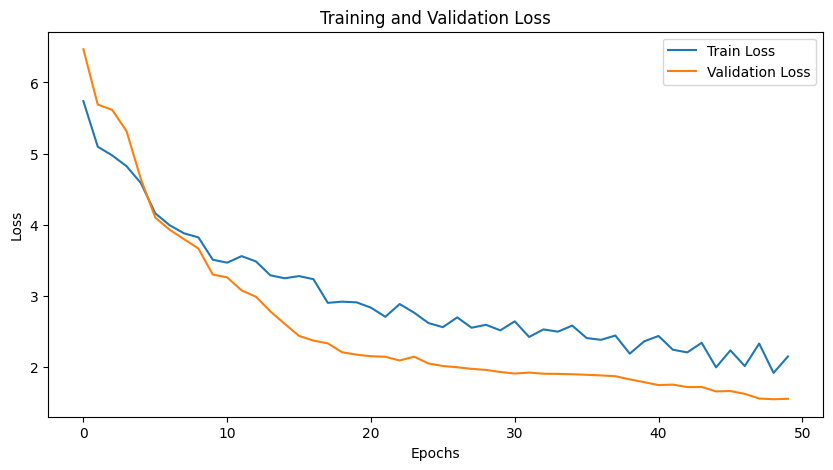

In [240]:
#plot
plt.figure(figsize=(10, 5))
plt.plot(range(num_epochs), train_losses, label='Train Loss')
plt.plot(range(num_epochs), val_losses, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

There we can see than for this nubmer of train photos is ok ~30 epoches for a good result. After 30 model starting to overfitting. So you can see it at the plot (i give you 40).

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
C:\Users\Mi\AppData\Local\Temp\ipykernel_16132\1970438464.py:71: FutureWarning: You 

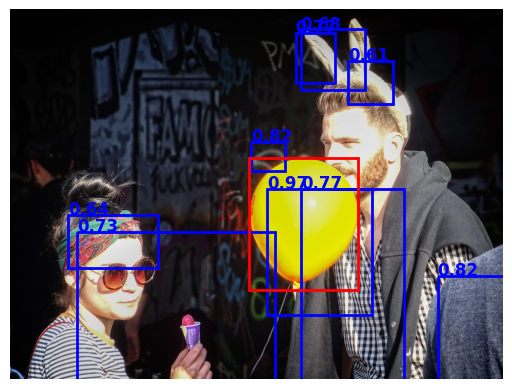

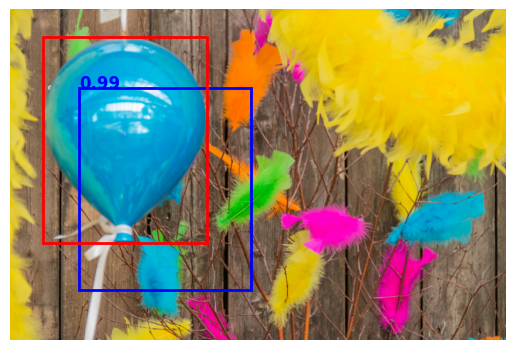

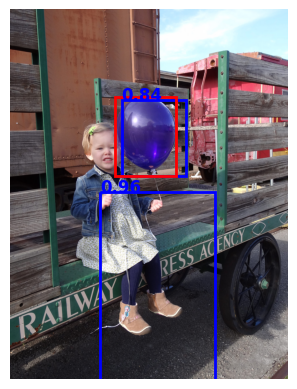

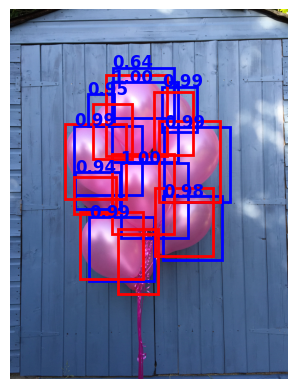

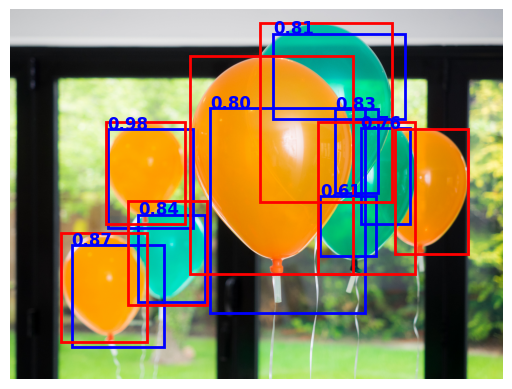

...

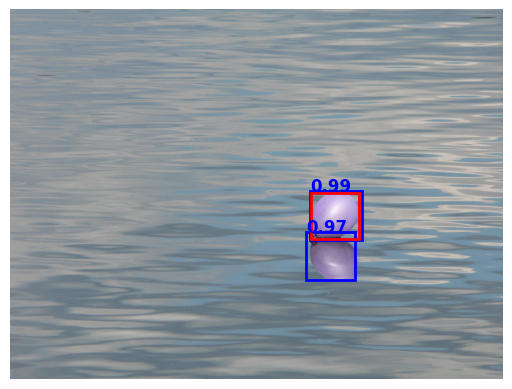

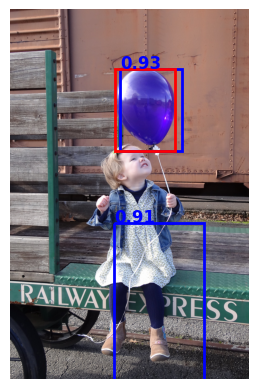

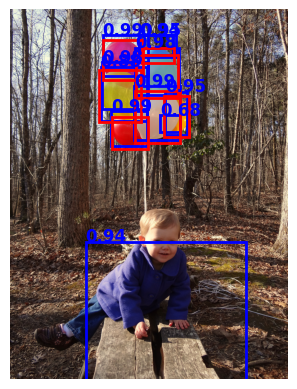

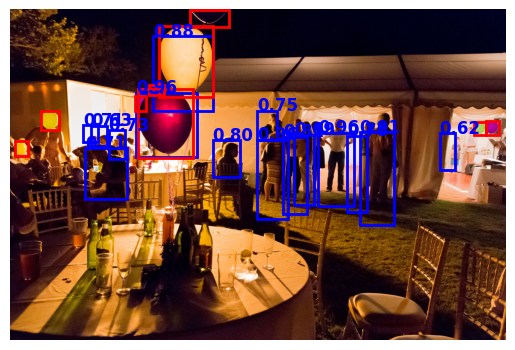

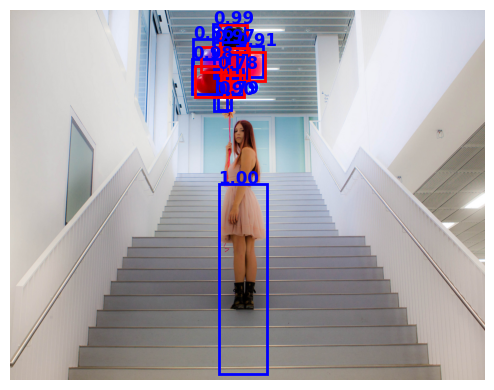

No boxes found after filtering for 6810773040_3d81036d05_k.jpg.


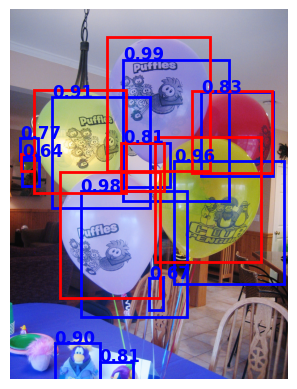

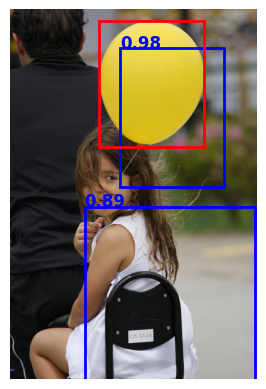

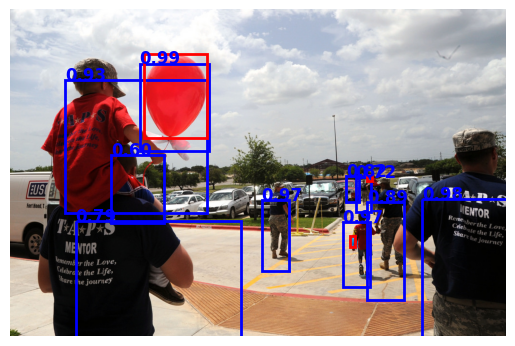

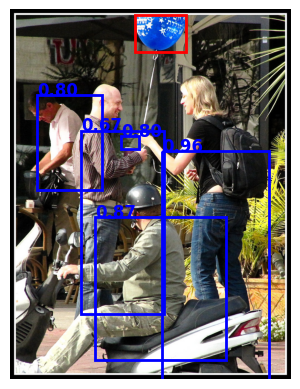

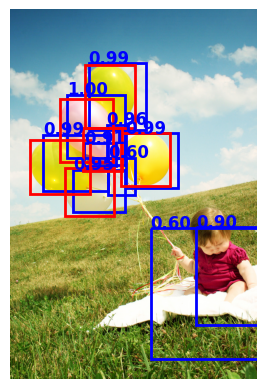

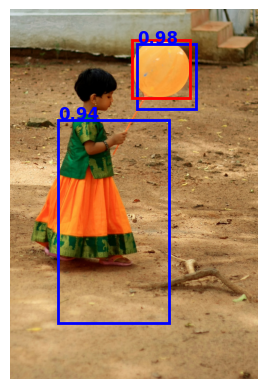

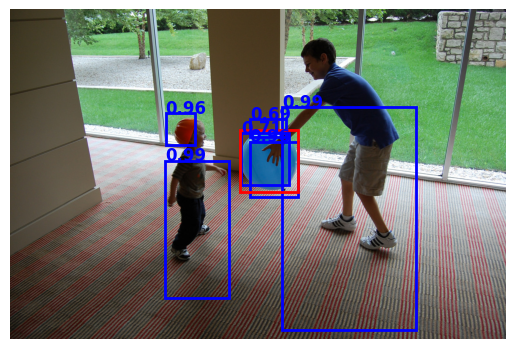

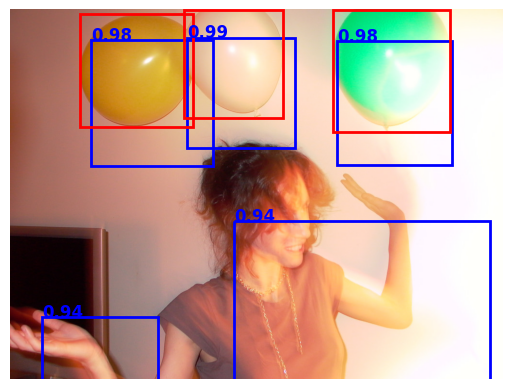

In [241]:
import os
import torch
import numpy as np
import pandas as pd
from PIL import Image
from transformers import DetrForObjectDetection, DetrImageProcessor
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw

def annot_to_dict(test_data):
    annotations = {}
    for _, row in test_data.iterrows():
        annotations[row['fname']] = eval(row['bbox'])  
    return annotations


def visualize_boxes(image, pred_boxes, true_boxes, scores):
    plt.imshow(image)
    ax = plt.gca()

    for i, box in enumerate(pred_boxes):
        rect = plt.Rectangle((box[0], box[1]), 
                             box[2] - box[0], 
                             box[3] - box[1], 
                             fill=False, color='blue', linewidth=2)
        ax.add_patch(rect)
        ax.text(box[0], box[1], f'{scores[i]:.2f}', color='blue', fontsize=12, weight='bold')

    for box in true_boxes:
        rect = plt.Rectangle((box['xmin'], box['ymin']), 
                             box['xmax'] - box['xmin'], 
                             box['ymax'] - box['ymin'], 
                             fill=False, color='red', linewidth=2)
        ax.add_patch(rect)

    plt.axis('off')
    plt.show()

def check_model(model_augm, images_dir, annotations, thr=0.6):
    for img_name in annotations.keys():
        img_path = os.path.join(images_dir, img_name)
        image = Image.open(img_path).convert("RGB")
        width, height = image.size  
        
        inputs = processor_augm(images=image, return_tensors="pt").to(device)

        with torch.no_grad():
            outputs = model_augm(**inputs)

        boxes = outputs.pred_boxes[0].cpu().numpy() # frames
        logits = outputs.logits[0].softmax(-1).cpu().numpy()  # probability
        scores = logits[:, 1]

        keep = scores > thr
        boxes = boxes[keep]

        if len(boxes) > 0:
            boxes[:, 0] *= width  # x_min
            boxes[:, 1] *= height  # y_min
            boxes[:, 2] = boxes[:, 2] * width + boxes[:, 0] 
            boxes[:, 3] = boxes[:, 3]* height + boxes[:, 1] 
            boxes = boxes.astype(int)  

            true_boxes = annotations.get(img_name, [])
            visualize_boxes(image, boxes, true_boxes, scores[keep])
        else:
            print(f"No boxes found after filtering for {img_name}.")

processor_augm = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")
model_augm = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50")
model_augm.load_state_dict(torch.load("best_model.pth"))
model_augm.eval()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_augm.to(device)

annotations = annot_to_dict(test_data)
check_model(model_augm, images_dir, annotations)

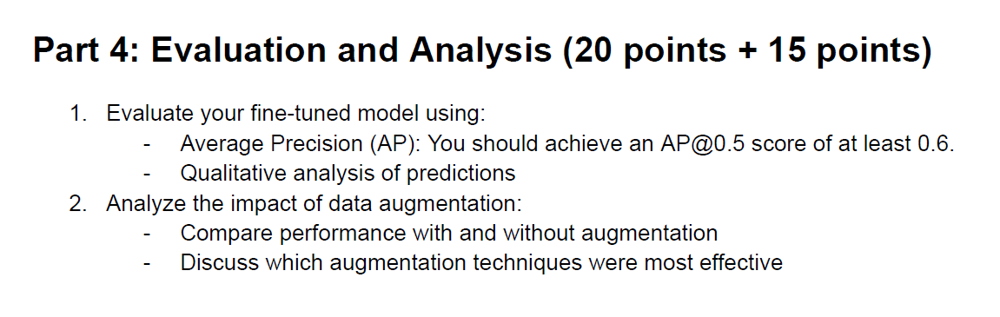

## AP  and other popular parametrs for analysys

In [243]:
import torch
from sklearn.metrics import precision_recall_curve, average_precision_score

#IoU
def calculate_iou(box1, box2):
    x1 = max(box1[0], box2[0])
    y1 = max(box1[1], box2[1])
    x2 = min(box1[2], box2[2])
    y2 = min(box1[3], box2[3])

    intersection = max(0, x2 - x1) * max(0, y2 - y1)
    area_box1 = (box1[2] - box1[0]) * (box1[3] - box1[1])
    area_box2 = (box2[2] - box2[0]) * (box2[3] - box2[1])
    
    union = area_box1 + area_box2 - intersection
    return intersection / union if union > 0 else 0

# AP
def evaluate_model(model, data_loader, device, iou_threshold=0.5, thr=0.8):
    model.eval() 
    all_true_boxes = []  
    all_pred_boxes = []  
    all_scores = []  
    all_binary_labels = [] 

    with torch.no_grad(): 
        for i, (images, boxes, class_labels) in enumerate(data_loader):
            images = torch.stack([image.to(device) for image in images])
            pixel_mask = torch.ones((images.size(0), images.size(2), images.size(3)), device=device, dtype=torch.bool)
    
            targets = [
                {
                    "boxes": torch.tensor(box, dtype=torch.float32).to(device),  # Ensure boxes are float32
                    "class_labels": torch.tensor(class_labels[i], dtype=torch.int64).to(device)  # Use "class_labels"
                } 
                for i, box in enumerate(boxes)
            ]
    
            outputs = model(images, pixel_mask=pixel_mask, labels=targets)
            boxes = outputs.pred_boxes[0].cpu().numpy()  
            logits = outputs.logits[0].softmax(-1).cpu().numpy()  
            scores = logits[:, 1]
    
            keep = scores > thr  
            boxes = boxes[keep]
            
            for true_box in boxes:
                all_true_boxes.append(true_box)

            for pred_box, score in zip(boxes, scores):
                all_pred_boxes.append(pred_box)
                all_scores.append(score)

                iou_values = [calculate_iou(pred_box, true_box) for true_box in all_true_boxes]
                
                if any(iou >= iou_threshold for iou in iou_values):
                    all_binary_labels.append(1)  # True Positive
                else:
                    all_binary_labels.append(0)  # False Positive

    # Precision-Recall Curve и Average Precision
    precision, recall, _ = precision_recall_curve(all_binary_labels, all_scores)
    ap = average_precision_score(all_binary_labels, all_scores)

    print(f"Augmented (AP) at IoU={iou_threshold}: {ap:.4f}")

    return precision, recall, ap 
precision, recall, ap = evaluate_model(model, test_loader, device)


Augmented (AP) at IoU=0.5: 0.7556


## no_augmented model 

Dont look that there are only 20 steps, i just give you 50 steps in augm model to show that 20-30 is ok. But i compared 30 to 30 read report

In [ ]:

processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")
model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50")
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)
num_epochs = 20
learning_rate = 5e-6
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)
best_val_loss = None
val_losses, train_losses = [], []

from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter()

train_dataset_no_augmented = CustomDataset(
    annotation_df=train_data,
    images_dir=images_dir,
    shuffle=True,
    augmentations=None
)

train_loader_no_augmented = DataLoader(
    train_dataset_no_augmented,
    batch_size=4,  
    shuffle=True,
    num_workers=0,
    collate_fn=collate_fn
)

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0

    for images, boxes, class_labels in tqdm(train_loader_no_augmented, desc=f"Training Epoch {epoch + 1}/{num_epochs}"):
        images = torch.stack([image.to(device) for image in images])
        pixel_mask = torch.ones((images.size(0), images.size(2), images.size(3)), device=device, dtype=torch.bool)

        targets = [
            {
                "boxes": torch.tensor(box, dtype=torch.float32).to(device),
                "class_labels": torch.tensor(class_labels[i], dtype=torch.int64).to(device)
            } 
            for i, box in enumerate(boxes)
        ]

        optimizer.zero_grad()
        outputs = model(images, pixel_mask=pixel_mask, labels=targets)
        loss = outputs.loss
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    avg_train_loss = running_loss / len(train_loader_no_augmented)
    print(f"Epoch [{epoch + 1}/{num_epochs}], Training Loss: {avg_train_loss:.4f}")
    train_losses.append(avg_train_loss)
    writer.add_scalar('Loss/Train', avg_train_loss, epoch)
    
    # Валидация
    model.eval()
    val_loss = 0
    with torch.no_grad():
        for images, boxes, class_labels in tqdm(val_loader, desc=f"Validation Epoch {epoch + 1}/{num_epochs}"):
            images = torch.stack([image.to(device) for image in images])
            pixel_mask = torch.ones((images.size(0), images.size(2), images.size(3)), device=device, dtype=torch.bool)
            targets = [
                {
                    "boxes": torch.tensor(box, dtype=torch.float32).to(device),
                    "class_labels": torch.tensor(class_labels[i], dtype=torch.int64).to(device)
                } 
                for i, box in enumerate(boxes)
            ]

            outputs = model(images, pixel_mask=pixel_mask, labels=targets)
            val_loss += outputs.loss.item()

    avg_val_loss = val_loss / len(val_loader)
    print(f"Epoch [{epoch + 1}/{num_epochs}], Validation Loss: {avg_val_loss:.4f}\n")
    val_losses.append(avg_val_loss)

    writer.add_scalar('Loss/Validation', avg_val_loss, epoch)

    if best_val_loss is None or val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save(model.state_dict(), "best_model_no_augmented.pth")

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Training Epoch 1/20: 100%|██████████| 13/13 [00:25<00:00,  1.96s/it]


Epoch [1/20], Training Loss: 6.5465


Validation Epoch 1/20: 100%|██████████| 3/3 [00:02<00:00,  1.21it/s]


Epoch [1/20], Validation Loss: 6.6886



Training Epoch 2/20: 100%|██████████| 13/13 [00:24<00:00,  1.87s/it]


Epoch [2/20], Training Loss: 5.8413


Validation Epoch 2/20: 100%|██████████| 3/3 [00:02<00:00,  1.30it/s]


Epoch [2/20], Validation Loss: 6.4712



Training Epoch 3/20: 100%|██████████| 13/13 [00:23<00:00,  1.83s/it]


Epoch [3/20], Training Loss: 5.8874


Validation Epoch 3/20: 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]


Epoch [3/20], Validation Loss: 6.2036



Training Epoch 4/20: 100%|██████████| 13/13 [00:24<00:00,  1.85s/it]


Epoch [4/20], Training Loss: 5.5792


Validation Epoch 4/20: 100%|██████████| 3/3 [00:02<00:00,  1.27it/s]


Epoch [4/20], Validation Loss: 5.9135



Training Epoch 5/20: 100%|██████████| 13/13 [00:24<00:00,  1.87s/it]


Epoch [5/20], Training Loss: 5.0185


Validation Epoch 5/20: 100%|██████████| 3/3 [00:02<00:00,  1.25it/s]


Epoch [5/20], Validation Loss: 5.4989



Training Epoch 6/20: 100%|██████████| 13/13 [00:24<00:00,  1.86s/it]


Epoch [6/20], Training Loss: 4.9419


Validation Epoch 6/20: 100%|██████████| 3/3 [00:02<00:00,  1.27it/s]


Epoch [6/20], Validation Loss: 5.3756



Training Epoch 7/20: 100%|██████████| 13/13 [00:24<00:00,  1.86s/it]


Epoch [7/20], Training Loss: 4.6408


Validation Epoch 7/20: 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]


Epoch [7/20], Validation Loss: 5.3992



Training Epoch 8/20: 100%|██████████| 13/13 [00:23<00:00,  1.84s/it]


Epoch [8/20], Training Loss: 4.7631


Validation Epoch 8/20: 100%|██████████| 3/3 [00:02<00:00,  1.28it/s]


Epoch [8/20], Validation Loss: 5.2220



Training Epoch 9/20: 100%|██████████| 13/13 [00:24<00:00,  1.86s/it]


Epoch [9/20], Training Loss: 4.6570


Validation Epoch 9/20: 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]


Epoch [9/20], Validation Loss: 5.0536



Training Epoch 10/20: 100%|██████████| 13/13 [00:24<00:00,  1.85s/it]


Epoch [10/20], Training Loss: 4.4526


Validation Epoch 10/20: 100%|██████████| 3/3 [00:02<00:00,  1.28it/s]


Epoch [10/20], Validation Loss: 4.8507



Training Epoch 11/20: 100%|██████████| 13/13 [00:24<00:00,  1.90s/it]


Epoch [11/20], Training Loss: 4.1822


Validation Epoch 11/20: 100%|██████████| 3/3 [00:02<00:00,  1.26it/s]


Epoch [11/20], Validation Loss: 4.6889



Training Epoch 12/20: 100%|██████████| 13/13 [00:24<00:00,  1.90s/it]


Epoch [12/20], Training Loss: 4.0258


Validation Epoch 12/20: 100%|██████████| 3/3 [00:02<00:00,  1.26it/s]


Epoch [12/20], Validation Loss: 4.5567



Training Epoch 13/20: 100%|██████████| 13/13 [00:24<00:00,  1.90s/it]


Epoch [13/20], Training Loss: 3.9736


Validation Epoch 13/20: 100%|██████████| 3/3 [00:02<00:00,  1.20it/s]


Epoch [13/20], Validation Loss: 3.9796



Training Epoch 14/20: 100%|██████████| 13/13 [00:25<00:00,  1.94s/it]


Epoch [14/20], Training Loss: 3.8384


Validation Epoch 14/20: 100%|██████████| 3/3 [00:02<00:00,  1.21it/s]


Epoch [14/20], Validation Loss: 3.8052



Training Epoch 15/20: 100%|██████████| 13/13 [00:25<00:00,  1.95s/it]


Epoch [15/20], Training Loss: 3.6455


Validation Epoch 15/20: 100%|██████████| 3/3 [00:02<00:00,  1.23it/s]


Epoch [15/20], Validation Loss: 3.6789



Training Epoch 16/20: 100%|██████████| 13/13 [00:25<00:00,  1.94s/it]


Epoch [16/20], Training Loss: 3.7334


Validation Epoch 16/20: 100%|██████████| 3/3 [00:02<00:00,  1.22it/s]


Epoch [16/20], Validation Loss: 3.5357



Training Epoch 17/20: 100%|██████████| 13/13 [00:25<00:00,  1.96s/it]


Epoch [17/20], Training Loss: 3.5589


Validation Epoch 17/20: 100%|██████████| 3/3 [00:02<00:00,  1.13it/s]


Epoch [17/20], Validation Loss: 3.4543



Training Epoch 18/20: 100%|██████████| 13/13 [00:25<00:00,  1.98s/it]


Epoch [18/20], Training Loss: 3.5583


Validation Epoch 18/20: 100%|██████████| 3/3 [00:02<00:00,  1.21it/s]


Epoch [18/20], Validation Loss: 3.3821



Training Epoch 19/20: 100%|██████████| 13/13 [00:25<00:00,  1.95s/it]


Epoch [19/20], Training Loss: 3.4329


Validation Epoch 19/20: 100%|██████████| 3/3 [00:02<00:00,  1.21it/s]


Epoch [19/20], Validation Loss: 3.3099



Training Epoch 20/20: 100%|██████████| 13/13 [00:26<00:00,  2.03s/it]


Epoch [20/20], Training Loss: 3.3153


Validation Epoch 20/20: 100%|██████████| 3/3 [00:02<00:00,  1.19it/s]

Epoch [20/20], Validation Loss: 3.2427



In [ ]:
# loss
model.load_state_dict(torch.load("best_model_no_augmented.pth"))
model.eval()
# for lest
test_loss = 0
with torch.no_grad():
    for images, boxes, class_labels in tqdm(test_loader, desc="Testing Model"):
        images = torch.stack([image.to(device) for image in images])
        pixel_mask = torch.ones((images.size(0), images.size(2), images.size(3)), device=device, dtype=torch.bool)
        targets = [
            {
                "boxes": torch.tensor(box, dtype=torch.float32).to(device),
                "class_labels": torch.tensor(class_labels[i], dtype=torch.int64).to(device)
            } 
            for i, box in enumerate(boxes)
        ]

        outputs = model(images, pixel_mask=pixel_mask, labels=targets)
        test_loss += outputs.loss.item()

avg_test_loss = test_loss / len(test_loader)
print(f"Test Loss: {avg_test_loss:.4f}")

C:\Users\Mi\AppData\Local\Temp\ipykernel_16132\2011595801.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("best_model_no_augmented.pth")

Test Loss: 3.6403


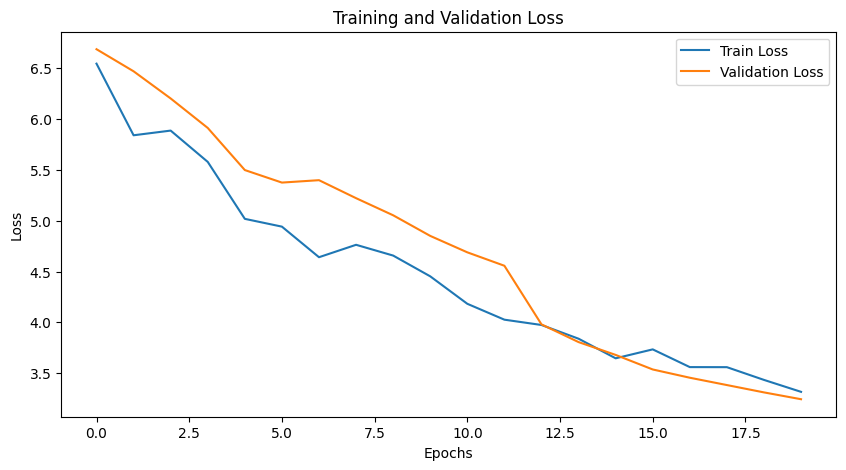

In [ ]:
#plot
plt.figure(figsize=(10, 5))
plt.plot(range(num_epochs), train_losses, label='Train Loss')
plt.plot(range(num_epochs), val_losses, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

In [238]:
import torch
from sklearn.metrics import precision_recall_curve, average_precision_score

# Функция для вычисления IoU (Intersection over Union)
def calculate_iou(box1, box2):
    x1 = max(box1[0], box2[0])
    y1 = max(box1[1], box2[1])
    x2 = min(box1[2], box2[2])
    y2 = min(box1[3], box2[3])

    intersection = max(0, x2 - x1) * max(0, y2 - y1)
    area_box1 = (box1[2] - box1[0]) * (box1[3] - box1[1])
    area_box2 = (box2[2] - box2[0]) * (box2[3] - box2[1])
    
    union = area_box1 + area_box2 - intersection
    return intersection / union if union > 0 else 0

# Оценка модели и вычисление AP (Average Precision)
def evaluate_model(model, data_loader, device, iou_threshold=0.5, thr=0.1):
    model.eval()  # Устанавливаем модель в режим оценки
    all_true_boxes = []  # Истинные боксы
    all_pred_boxes = []  # Предсказанные боксы
    all_scores = []  # Оценки для предсказанных боксов
    all_binary_labels = []  # Бинарные метки для правильных/неправильных предсказаний

    with torch.no_grad():  # Отключаем градиенты
        for images, boxes, class_labels in data_loader:
            images = torch.stack([image.to(device) for image in images])
            pixel_mask = torch.ones((images.size(0), images.size(2), images.size(3)), device=device, dtype=torch.bool)
    
            targets = [
                {
                    "boxes": torch.tensor(box, dtype=torch.float32).to(device),
                    "class_labels": torch.tensor(class_labels[i], dtype=torch.int64).to(device)
                } 
                for i, box in enumerate(boxes)
            ]
    
            # Прогоняем через модель
            outputs = model(images, pixel_mask=pixel_mask, labels=targets)
            boxes = outputs.pred_boxes[0].cpu().numpy()  # Предсказанные боксы
            logits = outputs.logits[0].softmax(-1).cpu().numpy()  # Вероятности
            scores = logits[:, 1]  # Для объектов, вероятно класс 1
            
            keep = scores > thr  # Фильтруем боксы по порогу уверенности
            boxes = boxes[keep]
            
            # Преобразуем предсказания и аннотации в формат для оценки
            for true_box in boxes:
                all_true_boxes.append(true_box)

            for pred_box, score in zip(boxes, scores):
                all_pred_boxes.append(pred_box)
                all_scores.append(score)

                # Вычисляем IoU для предсказанных боксов
                iou_values = [calculate_iou(pred_box, true_box) for true_box in boxes]
                
                # Если хотя бы один IoU превышает порог, считаем это True Positive
                if any(iou >= iou_threshold for iou in iou_values):
                    all_binary_labels.append(1)  # True Positive
                else:
                    all_binary_labels.append(0)  # False Positive

    # Вычисляем Precision-Recall Curve и Average Precision
    precision, recall, _ = precision_recall_curve(all_binary_labels, all_scores)
    ap = average_precision_score(all_binary_labels, all_scores)

    print(f"Average Precision (AP) at IoU={iou_threshold}: {ap:.4f}")

    return precision, recall, ap  # Возвращаем значения

# Пример использования
# model - ваша модель, test_loader - загрузчик тестовых данных, device - устройство (CPU или GPU)
precision, recall, ap = evaluate_model(model, test_loader, device)


Average Precision (AP) at IoU=0.5: 0.2932


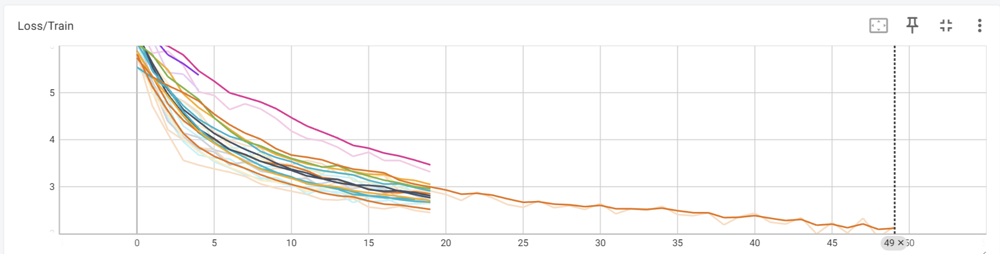

In [1]:
%load_ext tensorboard
%tensorboard --logdir lightning_logs